In [1]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2

In [2]:
! pip install xmltodict

fastai 1.0.60 requires nvidia-ml-py3, which is not installed.
You are using pip version 10.0.1, however version 20.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [3]:
from od_prep.builder.od_prep import OdPrep

In [4]:
from fastai import *
from fastai.vision import *




In [5]:
import pdb

In [6]:
ROOT_PATH=Path('/home/ec2-user/SageMaker/RCNN-with-fastai/')
DATA_PATH=Path(ROOT_PATH/'data')
MODEL_PATH=Path(ROOT_PATH/'model')
TRAIN_PATH=Path(ROOT_PATH/'train')

ANNOTATIONS_PATH = Path(DATA_PATH/'annotated/annotations')
IMAGES_PATH = Path(DATA_PATH/'annotated/images')
ALL_IMAGES_PATH = Path(DATA_PATH/'all_images')
ALL_DATA_PATH = Path(DATA_PATH/'all_data.json')

In [10]:
with open(ALL_DATA_PATH, 'r') as f:  all_json = json.loads(f.read())

### Use the `od_prep` library to load the dataset and prepare it for the Dataloaders 

In [9]:
o = OdPrep(annot_folder=ANNOTATIONS_PATH, images_folder=IMAGES_PATH, all_images_folder=ALL_IMAGES_PATH)
xx = o()

DestinationFolderNotEmpty: Destination Folder is not empty

In [52]:
all_json = xx.all_data

def find_unannotated():
    for file in ALL_IMAGES_PATH.ls(): 
        if not imgs2bbox.get(file.name, None):  print(file)

def write_to_json(data, file_path:Path):
    with open(file_path, 'w') as f: f.write(json.dumps(data))

# write_to_json(all_json, ALL_DATA_PATH)        

In [201]:

cat_8 = lambda x: x['category_id'] == 8
list(filter(cat_8, all_json['annotations']))

def filter_imgs(x, ids=[5, 6, 4]):
    if x['id'] in ids: return True
    else: False
        
list(filter(filter_imgs, all_json['images']))

# all_json['categories']

[{'file_name': '5.jpg', 'height': 225.0, 'width': 225.0, 'id': 5},
 {'file_name': '6.jpg', 'height': 225.0, 'width': 225.0, 'id': 6},
 {'file_name': '4.jpg', 'height': 238.0, 'width': 212.0, 'id': 4}]

In [200]:
# all_json

In [11]:
imgs, lbl_bbox = get_annotations(ALL_DATA_PATH)

In [12]:
imgs2bbox = dict(zip(imgs, lbl_bbox))
imgs2bbox

{'5.jpg': [[[31, 163, 239, 372],
   [45, 81, 253, 204],
   [29, 119, 235, 288],
   [13, 24, 224, 104]],
  ['trèStiQue Tint, Moisturize & Blend Face Stick',
   'trèStiQue Tint, Moisturize & Blend Face Stick',
   'trèStiQue Tint, Moisturize & Blend Face Stick Box',
   'trèStiQue Tint, Moisturize & Blend Face Stick Box']],
 '6.jpg': [[[1, 45, 225, 216]],
  ['trèStiQue Tint, Moisturize & Blend Face Stick Box']],
 '11.jpg': [[[24, 30, 243, 185]],
  ['trèStiQue Tint, Moisturize & Blend Face Stick']],
 '1.jpg': [[[1, 72, 224, 226]],
  ['trèStiQue Tint, Moisturize & Blend Face Stick']],
 '4.jpg': [[[67, 83, 289, 266], [4, 7, 196, 98]],
  ['trèStiQue Tint, Moisturize & Blend Face Stick',
   'trèStiQue Tint, Moisturize & Blend Face Stick Box']],
 '9.jpg': [[[22, 50, 224, 207]],
  ['trèStiQue Tint, Moisturize & Blend Face Stick']],
 '7.jpg': [[[1, 52, 225, 222]],
  ['trèStiQue Tint, Moisturize & Blend Face Stick']],
 '2.jpg': [[[24, 21, 239, 162]],
  ['trèStiQue Tint, Moisturize & Blend Face Stic

In [13]:
from fastai.vision.data import bb_pad_collate

In [90]:
bs=16

In [91]:
tfms = get_transforms(max_zoom=1.1, max_warp=0.05, max_rotate=0.05)

In [92]:
def get_y_func(o):
    bbox_classes = imgs2bbox.get(o.name, None)
    if not bbox_classes: raise Exception
    bbox, classes = bbox_classes
    return [bbox, classes]

In [93]:
data = ObjectItemList.from_folder(ALL_IMAGES_PATH)
data = data.split_by_rand_pct(valid_pct=0.3)
data = data.label_from_func(get_y_func)
data = data.transform(tfms,
                     tfm_y=True, size=224, resize_method=ResizeMethod.SQUISH)
data = data.databunch(bs=bs, collate_fn=bb_pad_collate)
data = data.normalize(imagenet_stats)

/home/ec2-user/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/matplotlib/tight_layout.py:199: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  warnings.warn('Tight layout not applied. '


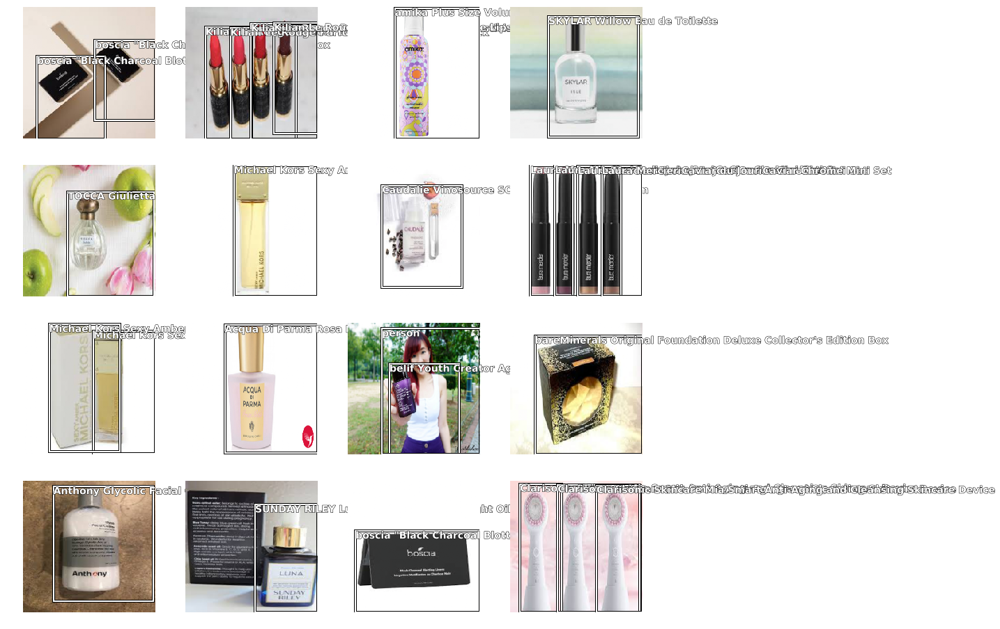

In [94]:
data.show_batch(ds_type=DatasetType.Valid)

/home/ec2-user/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/matplotlib/tight_layout.py:199: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  warnings.warn('Tight layout not applied. '


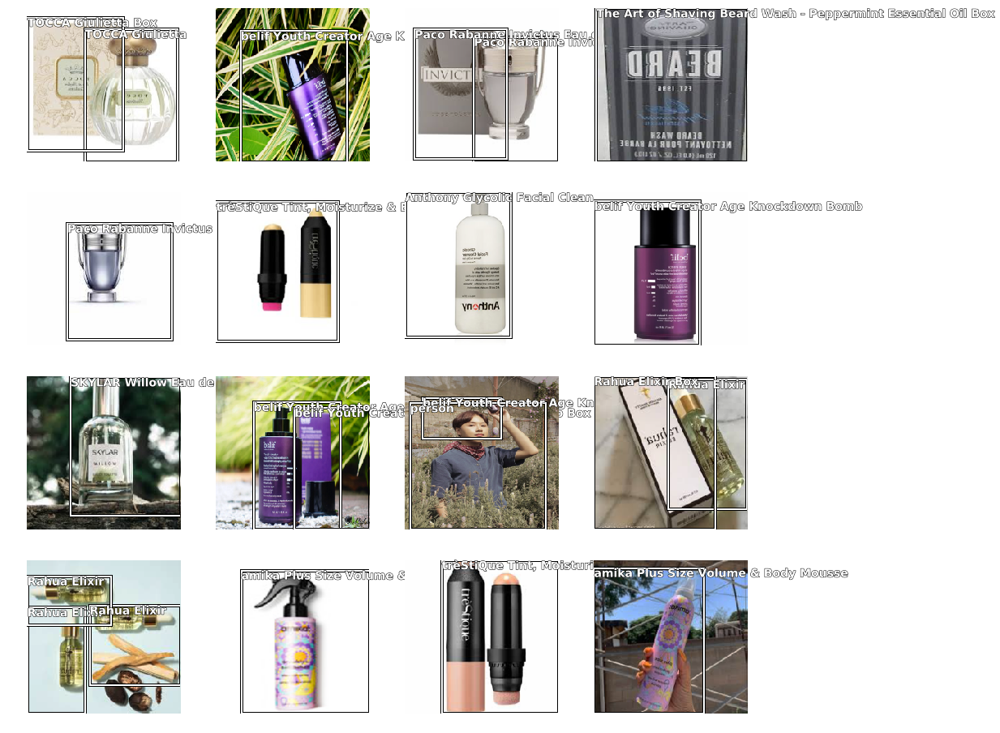

In [95]:
data.show_batch(ds_type=DatasetType.Train)

In [96]:
len(data.train_ds)

136

In [97]:
class StdConv(nn.Module):
    def __init__(self, nin, nout, kernel_size=3, stride=2, padding=1, drop=0.2):
        super().__init__()
        self.conv = nn.Conv2d(nin, nout, kernel_size=kernel_size, stride=stride, padding=padding)
        self.bn = nn.BatchNorm2d(nout)
        self.drop = nn.Dropout(drop)
        
    def forward(self, x): return self.drop(self.bn(F.relu(self.conv(x))))      



In [98]:
def flatten_conv(x, k, debug=False):
    if debug: print(f'[Flatten] Input shape {x.shape}, k={k}')        
        
    bs, num_features, row, cols = x.shape
    flattened = x.view(bs, num_features//k, -1)
    
    if debug: print(f'[Flatten-2] Flattened shape {flattened.shape}')
        
    return flattened.permute(0,2,1)

In [99]:
class OutConv(nn.Module):
    def __init__(self, k, nin, num_classes, bias):
        super().__init__()
        self.k = k
        self.oconv1 = nn.Conv2d(in_channels=nin, out_channels=(num_classes * k), kernel_size=3, padding=1, bias=True)
        self.oconv2 = nn.Conv2d(in_channels=nin, out_channels=(4*k), kernel_size=3, padding=1, bias=True)
        
    def forward(self, x, debug=False):
        _classes = self.oconv1(x)
        _coords = self.oconv2(x)
        
        classes, coords = flatten_conv(_classes, self.k), flatten_conv(_coords, self.k)
        return [classes, coords]
    
        
    

In [100]:
class SSDHead(nn.Module):
    def __init__(self, k, bias, num_of_classes):
        super().__init__()
        self.drop = nn.Dropout(0.5)      
        self.sconv0 = StdConv(512, 256, stride=1) #256x7x7
        self.sconv1 = StdConv(256, 256, stride=1)
        self.sconv2 = StdConv(256, 256) #256x4x4
        self.sconv3 = StdConv(256, 256) #256x2x2
        self.sconv4 = StdConv(256, 256) #256x1x1
        self.out = OutConv(k, 256, num_of_classes, bias)
        
    def forward(self, x, debug=False):
        if debug: print(f'[SSDhead] input shape {x.shape}')
        
        x = self.drop(F.relu(x))
        if debug: print(f'[SSDHead-1] relu-dropout output shape {x.shape}')        
        
        x = self.sconv0(x)
        if debug: print(f'[SSDHead-2] sconv0 output shape {x.shape}')
        
        x = self.sconv1(x)
        x = self.sconv2(x)
        c1, bb1 = self.out(x)        
        
        if debug: print(f'[SSDHead-3] sconv2 output shape {x.shape}')
            
        x = self.sconv3(x)
        c2, bb2 = self.out(x)
        
        if debug: 
            print(f'[SSDHead-4] sconv3 output shape {x.shape}')
            print(f'[SSDHead-4] c2 {c2.shape}  bb1: {bb2.shape}')
        
        x = self.sconv4(x)
        c3, bb3 = self.out(x)
        
        if debug: 
            print(f'[SSDHead-5] sconv4 output shape {x.shape}')        
            print(f'[SSDHead-5] c1 {c1.shape}  bb1: {bb1.shape}')
            print(f'[SSDHead-5] c2 {c2.shape}  bb1: {bb2.shape}')
            print(f'[SSDHead-5] c3 {c3.shape}  bb1: {bb3.shape}')
        
        c, bb = torch.cat([c1, c2, c3], dim=1), torch.cat([bb1, bb2, bb3], dim=1)        
        if debug: print(f'[SSDHead-6] concatenated shape c: {c.shape}, b:{bb.shape}')
            
        return [c, bb]
    

In [101]:
def get_scaled_anchors():    
    anc_grids = [4, 2, 1]
    anc_zooms = [0.7, 1., 1.3]
    anc_ratios = [(1., 1.), (1., 0.5), (0.5, 1.)]

    anchor_scales = [(anz*i,anz*j) for anz in anc_zooms 
                                        for (i,j) in anc_ratios]
    # *** Number of Anchor Scales
    k = len(anchor_scales)
    # ***************************

    anc_offsets = [2/(o*2) for o in anc_grids] #2 is the h,w in fastai 1.0 (-1,1)
    anc_x = np.concatenate([np.repeat(np.linspace(ao-1, 1-ao, ag), ag)
                            for ao,ag in zip(anc_offsets,anc_grids)])
    anc_y = np.concatenate([np.tile(np.linspace(ao-1, 1-ao, ag), ag)
                            for ao,ag in zip(anc_offsets,anc_grids)])
    anc_ctrs = np.repeat(np.stack([anc_x,anc_y], axis=1), k, axis=0)
    anc_sizes = np.concatenate([np.array([[2*o/ag,2*p/ag] 
                  for i in range(ag*ag) for o,p in anchor_scales])
                     for ag in anc_grids]) #2/grid * scale,2 is the h,w in fastai 1.0
    grid_sizes = tensor(np.concatenate([np.array([ 1/ag 
                  for i in range(ag*ag) for o,p in anchor_scales])
                      for ag in anc_grids])).unsqueeze(1) *2 #again fastai 1.0 h,w is 2
    anchors = tensor(np.concatenate([anc_ctrs, anc_sizes], axis=1)).float()
#     anchor_cnr = cthw2corners(anchors)
    print(f'K is {k}')
    return anchors, grid_sizes

anchors, grid_sizes = get_scaled_anchors()

K is 9


In [102]:
data.train_ds[0]

(Image (3, 224, 224), ImageBBox (224, 224))

K is 9


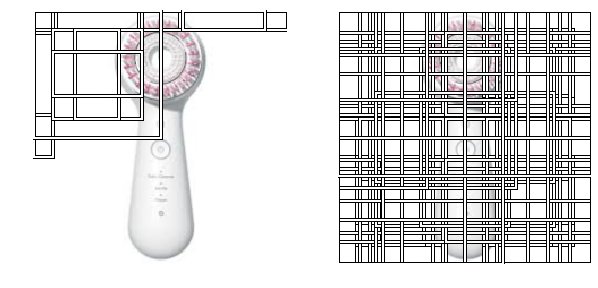

In [103]:
def show_anchors(img=None):
    img, bbox = data.train_ds[3]
    anchors, _ = get_scaled_anchors()
    anchor_centers = anchors[:, :2]
    anchor_hw = anchors[:, 2:]
    anchor_coords = hw2corners_(anchor_centers, anchor_hw)
    anchor_coords = anchor_coords * 224.
    anchor_coords1 = anchor_coords[:len(anchor_coords)//2]
    anchor_coords2 = anchor_coords[len(anchor_coords)//2:]
    bb= ImageBBox.create(*img.size, anchor_coords1)
    bb2= ImageBBox.create(*img.size, anchor_coords2)
    
    fig, axes = plt.subplots(1, 2, figsize=(10, 8))   
    img.show(ax=axes[0], y=bb)
    img.show(ax=axes[1], y=bb2)
    
show_anchors()

In [104]:
data.c
data.classes

['background',
 'Acqua Di Parma Rosa Nobile Hair Mist',
 'Acqua Di Parma Rosa Nobile Hair Mist box',
 'Anthony Glycolic Facial Cleanser',
 'Caudalie Vinosource SOS Deep Hydration Serum',
 'Clarisonic Skincare Mia Smart Anti-Aging and Cleansing Skincare Device',
 'Kilian Le Rouge Parfum Scented Matte Lipstick',
 "L'Homme Yves Saint Laurent",
 "L'Homme Yves Saint Laurent Box",
 'Laura Mercier Caviar du Jour Caviar Chrome Mini Set',
 'Laura Mercier Caviar du Jour Caviar Chrome Mini Set box',
 'Marc Jacobs Fragrances Daisy Dream',
 'Marc Jacobs Fragrances Daisy Dream box',
 'Michael Kors Sexy Amber',
 'Michael Kors Sexy Amber box',
 'Paco Rabanne Invictus Eau de Toilette',
 'Paco Rabanne Invictus Eau de Toilette Box',
 'Rahua Elixir',
 'Rahua Elixir Box',
 'SKYLAR Willow Eau de Toilette',
 'SKYLAR Willow Eau de Toilette Box',
 'SUNDAY RILEY Luna Retinol Sleeping Night Oil',
 'SUNDAY RILEY Luna Retinol Sleeping Night Oil Box',
 'TOCCA Giulietta',
 'TOCCA Giulietta Box',
 'The Art of Shaving

In [105]:
k = 9
bias = -4.
head_reg4 = SSDHead(k, bias, data.c)


### Loss


In [106]:
def one_hot_embedding(labels, num_classes, debug=False):
    if debug: 
        print(f'labels: {labels} {labels.shape}')
        print(f'num_classes: {num_classes}')
        print(f'lables.data {labels.data}')
    return torch.eye(num_classes)[labels.data.cpu()]

class BCE_Loss(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.num_classes = num_classes

    def forward(self, pred, targ):
        """
        The t[:, 1:] and p[:, 1:] ensures the first class `background` is ignored in both target and predicted classes
        """        
        t = one_hot_embedding(targ, self.num_classes)[:, 1:]
        t= t.cuda()
        x = pred[:,1:]       
        w = self.get_weight(x,t,focal_loss=True) # for focal loss
        return F.binary_cross_entropy_with_logits(x, t, w, reduction='sum')/(self.num_classes - 1)
    
    def get_weight(self,x,t, focal_loss=False): 
        if not focal_loss: return None
        x,t = x.cpu(),t.cpu()
        alpha,gamma = 0.25,2.
        p = x.sigmoid()
        pt = p*t + (1-p)*(1-t)
        w = alpha*t + (1-alpha)*(1-t)
        return (w * (1-pt).pow(gamma)).cuda().detach()
    

### Utilities

In [107]:
def get_nonzero(bbox,classes):
    """
    Accepts a target_coords and classes
    1. bbox: target_coords 
    2. classes: target_classes
    
    It ensures thes shape is [whatever size x 4], ie: groups of 4 coords
    It checks if the difference between x2 - x1 is > 0  and filters all the `nonzero` values indexes
    
    And using those indexes `bb_keep` returns those from the orignal `bbox` and `classes` arrays
    """
    #bbox = bbox.view(-1,4)/224.
    bbox = bbox.view(-1,4)
    retain_idxs = ((bbox[:,2]-bbox[:,0])>0).nonzero()[:,0]
    return bbox[retain_idxs],classes[retain_idxs]

# Getting rid of -ve values 
def normalize(bbox, debug=False):
    if debug:
        print(f'[NORMALIZE] bbox: {bbox} bbox.sum: {bbox.sum()} bbox.std: {bbox.std()} bbox.mean: {bbox.mean()}')
    return (bbox+1./2.)


def hw2corners_(ctr, hw):
    """
    Given the center and the height and width returns the 4 corners of a bounding box
    """
    return torch.cat([ctr-hw/2, ctr+hw/2], dim=1)


def intersect(box_a, box_b):
    """
    for a given set of pred_coords and anchor boxes
    1. `max_xy` finds the right most top left coordinates. That is max(x) and max(y)
    2. `min_xy` finds the furthest bottom right,  `bottom left`. That is min(x) and min(y)
    3. `clamp` ensures the values are greater than 0
    4. `inter * inter` computes the areas of the two sets of coordinates and returns the overlapping area.
    """
    top_left = torch.max(box_a[:, None, :2], box_b[None, :, :2])
    bottom_right = torch.min(box_a[:, None, 2:], box_b[None, :, 2:])
    inter = torch.clamp((bottom_right - top_left), min=0)
    return inter[:, :, 0] * inter[:, :, 1]

def box_area(b): 
    return ((b[:, 2]-b[:, 0]) * (b[:, 3]-b[:, 1]))

def jaccard(box_a, box_b, debug=False):
    """
    Intersection over union
    """
    if debug:
        print(f'[JACCARD] box_a: {box_a}')
        print(f'[JACCARD] box_b: {box_b}')
    inter = intersect(box_a, box_b)
    union = box_area(box_a).unsqueeze(1) + box_area(box_b).unsqueeze(0) - inter
    return inter / union


def actn_to_bb(actn, anchors, grid_sizes, debug=False):
    """
    Given a set of 
    1. actn: activations from a prediction
    2. anchors: Anchors computed beforehand for a default image of size 1x1. (anchors)
    3. grid_sizes: Grid size for each of the bounding box on the default image
    4. The tanh converts the values between -1 and 1
    Anchors return the list of (anchor_centers, anchor_sizes)
    
    """    
    actn_bbs = torch.tanh(actn)
    if debug:
        print(f'actn_bbs: {actn_bbs.shape} anchors: {anchors.shape} grid_size: {grid_sizes.shape}')
        
    actn_centers = (actn_bbs[:,:2]/2 * grid_sizes) + anchors[:,:2]
    actn_hw = (actn_bbs[:,2:]/2+1) * anchors[:,2:]
    return hw2corners_(actn_centers, actn_hw)

def map_to_ground_truth(overlaps, debug=False):
    """
    `overlaps.max(1)`:
        1. returns the overlap of the activations with the ground truth anchor boxes
        2. Which is returns the largest overlaps (area) and anchor box index       
    
    `overlaps.max(0)`:
        1. returns overlap of activations overlap with respect to each of the
           ground truth boxes
        2. For every anchor box in our anchors the overlap area and the activation that overlapped
     
     The function assigns every anchor box to a ground truth label.
    """
    if debug: print(f'[MAP_TO_GROUND_TRUTH] overlaps: {overlaps}')
    overlap_val, overlap_idx = overlaps.max(1)    
    gt_overlap, gt_idx = overlaps.max(0) 
    
    if debug: 
        print(f'[MAP_TO_GROUND_TRUTH] overlap_val:{overlap_val}, overlap_idx:{overlap_idx}')
        print(f'[MAP_TO_GROUND_TRUTH] gt_overlaps: {gt_overlap}, gt_idx:{gt_idx}')
        
    gt_overlap[overlap_idx] = 1.99
    for ix, overlap_index in enumerate(overlap_idx):
        gt_idx[overlap_index]=ix
        
    if debug:
        print(f'[MAP_TO_GROUND_TRUTH] gt_overlaps: {gt_overlap}')
        print(f'[MAP_TO_GROUND_TRUTH] gt_idx: {gt_idx}')      
            
    return gt_overlap, gt_idx   
    
    

def ssd_1_loss(p_cls, p_coords, t_cls, t_coords, debug=False):
    t_coords, t_cls = get_nonzero(t_coords, t_cls) # this divides by 224 to work on 1x1 image size  
    #t_coords = normalize(t_coords) # we do this to obtain non-negative bounding boxes to train on.
    
    anchor_centers = anchors[:, :2]
    anchor_hw = anchors[:, 2:]
    anchor_coords = hw2corners_(anchor_centers.cuda(), anchor_hw.cuda())          
              
    overlaps = jaccard(t_coords, anchor_coords.cuda())
    try:
        gt_overlap, gt_idx = map_to_ground_truth(overlaps)
    except Exception as e:
        return 0., 0.
    
    gt_classes = t_cls[gt_idx]
    positive_overlaps = gt_overlap > 0.4
    positive_overlaps_idx = torch.nonzero(positive_overlaps)[:, 0]

    # if the overlaps are False replace that with 21 for all else retain the actual class label index
    gt_classes[~positive_overlaps] = 0   
    
    gt_bbox = t_coords[gt_idx]
    actn_centers_hw = actn_to_bb(p_coords, anchors.cuda(), grid_sizes.cuda())  
    loc_loss = (
        actn_centers_hw[positive_overlaps_idx] - gt_bbox[positive_overlaps_idx]
    ).abs().mean()
    class_loss_func = BCE_Loss(data.c)

    class_loss = class_loss_func(p_cls, gt_classes)
    return loc_loss, class_loss  
    

def ssd_loss(pred, targ, target_class, debug=False): 
    
    pred_classes, pred_coords = pred
    if debug: print(f'classes shape: {pred_classes.shape} coords_shape: {pred_coords.shape}')
    
    # For each set of 16x4 coords and 16x(num_classes) per image in a batch compute the loss
    regression_loss, class_loss = 0., 0.
    for p_cls, p_coords, t_coords, t_cls in zip(pred_classes, pred_coords, targ, target_class):        
        l1_loss, cls_loss = ssd_1_loss(p_cls, p_coords, t_cls, t_coords)
        regression_loss += l1_loss
        class_loss += cls_loss     
    
    if debug: print(f'regression_loss: {regression_loss}, class_loss: {class_loss}')     
     
    return regression_loss + class_loss

In [108]:
learn = None
learn = cnn_learner(data, models.resnet34, custom_head=head_reg4, loss_func=ssd_loss)

In [109]:
learn.lr_find()

epoch,train_loss,valid_loss,time
0,1021.508057,#na#,00:04
1,1019.079529,#na#,00:02
2,1018.046143,#na#,00:02
3,1015.813599,#na#,00:02
4,1009.122742,#na#,00:02
5,985.851196,#na#,00:02
6,883.708740,#na#,00:02
7,711.980103,#na#,00:02
8,576.393005,#na#,00:02
9,471.814026,#na#,00:02


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 3.02E-03
Min loss divided by 10: 1.32E-01


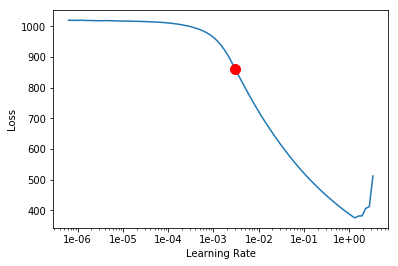

In [110]:
learn.recorder.plot(suggestion=True)

In [111]:
learn.fit_one_cycle(15, slice(3.02E-03))

epoch,train_loss,valid_loss,time
0,980.183044,452.993313,00:04
1,860.208496,75.581820,00:03
2,601.054688,110.282895,00:03
3,422.705414,58.033753,00:03
4,315.470520,23.228442,00:03
5,244.761581,25.018162,00:03
6,195.021011,19.932711,00:03
7,158.342316,15.305230,00:03
8,130.414368,13.124402,00:03
9,108.628151,11.765349,00:03


In [112]:
learn.freeze_to(-2)

In [113]:
learn.lr_find()

epoch,train_loss,valid_loss,time
0,11.037363,#na#,00:03
1,10.893247,#na#,00:02
2,10.828266,#na#,00:03
3,10.744706,#na#,00:02
4,10.678076,#na#,00:02
5,10.500587,#na#,00:02
6,10.013506,#na#,00:03
7,13.870970,#na#,00:02


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


In [115]:
learn.save(MODEL_PATH/'stage-1')

Min numerical gradient: 1.10E-06
Min loss divided by 10: 3.31E-05


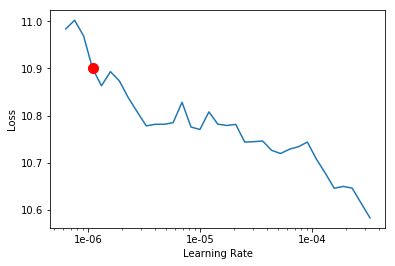

In [114]:
learn.recorder.plot(suggestion=True, skip_end=20)

In [116]:
learn.fit_one_cycle(10, slice(1.10E-06,1e-04))

epoch,train_loss,valid_loss,time
0,10.799091,9.330513,00:04
1,10.753580,9.106407,00:03
2,10.629510,8.906500,00:03
3,10.434576,8.584346,00:03
4,10.246067,8.347397,00:03
5,10.024768,8.090248,00:03
6,9.813479,7.882058,00:03
7,9.650230,7.735221,00:03
8,9.540709,7.731079,00:03
9,9.394771,7.716097,00:03


In [117]:
learn.save(MODEL_PATH/'stage-2')

In [118]:
learn.unfreeze()

epoch,train_loss,valid_loss,time
0,8.869192,#na#,00:03
1,8.887725,#na#,00:03
2,8.889817,#na#,00:02
3,8.893606,#na#,00:03
4,8.847019,#na#,00:02
5,8.765869,#na#,00:03
6,8.426064,#na#,00:03
7,8.300824,#na#,00:03


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.
Min numerical gradient: 1.00E-05
Min loss divided by 10: 7.59E-08


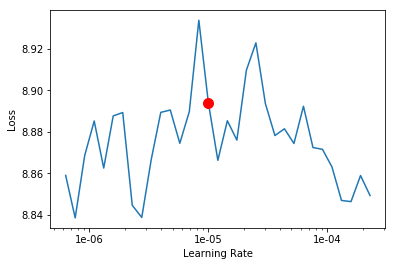

In [119]:
learn.lr_find()
learn.recorder.plot(suggestion=True, skip_end=20)

Min numerical gradient: 1.00E-05
Min loss divided by 10: 5.75E-05


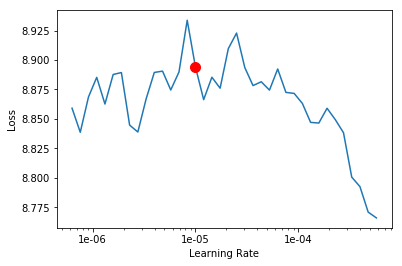

In [120]:
learn.recorder.plot(suggestion=True, skip_end=20)

In [121]:
learn.fit_one_cycle(10, slice(1e-05, 6e-05, 3e-04))

epoch,train_loss,valid_loss,time
0,8.897799,7.733365,00:04
1,8.922992,7.685471,00:03
2,8.847877,7.538448,00:04
3,8.821260,7.358431,00:04
4,8.698352,7.198375,00:04
5,8.583903,7.115711,00:04
6,8.495051,7.073193,00:04
7,8.406622,7.088898,00:04
8,8.358401,7.088334,00:04
9,8.295568,7.103262,00:04


In [122]:
learn.save(MODEL_PATH/'stage-3')

epoch,train_loss,valid_loss,time
0,8.148500,#na#,00:03
1,8.136293,#na#,00:03
2,8.128608,#na#,00:03
3,8.040915,#na#,00:03
4,8.035956,#na#,00:03
5,8.015316,#na#,00:03
6,7.938955,#na#,00:03
7,7.664780,#na#,00:03
8,18.220652,#na#,00:03
9,18.361263,#na#,00:03


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.
Min numerical gradient: 3.80E-03
Min loss divided by 10: 5.75E-04


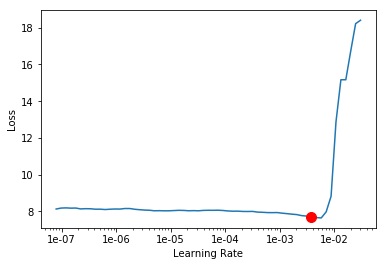

In [148]:
learn.lr_find(start_lr=1e-08)
learn.recorder.plot(suggestion=True, skip_end=20)

Min numerical gradient: 2.19E-06
Min loss divided by 10: 1.35E-04


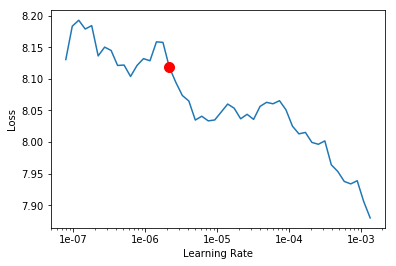

In [151]:
learn.recorder.plot(suggestion=True, skip_end=35)

In [152]:
learn.fit_one_cycle(10, slice(2.19e-06, 1e-04))

epoch,train_loss,valid_loss,time
0,7.911799,7.066929,00:04
1,7.850985,6.974147,00:04
2,7.851614,6.754528,00:04
3,7.762527,6.544799,00:04
4,7.644916,6.394793,00:04
5,7.528639,6.352823,00:03
6,7.430690,6.253919,00:04
7,7.327692,6.152102,00:04
8,7.262947,6.140405,00:04
9,7.203483,6.118166,00:04


In [153]:
learn.save(MODEL_PATH/'stage-4')

epoch,train_loss,valid_loss,time
0,6.945448,#na#,00:03
1,6.956524,#na#,00:03
2,6.931606,#na#,00:03
3,6.918413,#na#,00:03
4,6.900320,#na#,00:03
5,6.870860,#na#,00:03
6,6.858357,#na#,00:03
7,6.808589,#na#,00:03
8,12.644031,#na#,00:03
9,16.737852,#na#,00:03


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.
Min numerical gradient: 5.13E-07
Min loss divided by 10: 7.24E-05


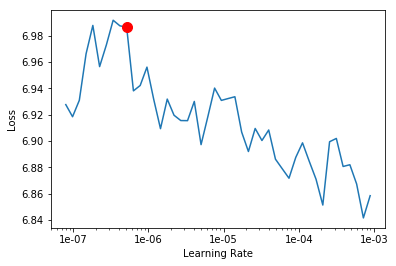

In [157]:
learn.lr_find(start_lr=1e-08)
learn.recorder.plot(suggestion=True, skip_end=35)

In [158]:
learn.fit_one_cycle(10, slice(5.13E-07, 3e-05, 1.6e-04))

epoch,train_loss,valid_loss,time
0,6.900358,6.133503,00:04
1,6.903600,6.085435,00:04
2,6.864932,6.082362,00:04
3,6.818299,6.047661,00:04
4,6.788190,6.020067,00:04
5,6.761739,5.953579,00:04
6,6.732034,5.895020,00:04
7,6.736677,5.898851,00:04
8,6.726468,5.904592,00:04
9,6.726518,5.896416,00:04


In [159]:
learn.save(MODEL_PATH/'stage-5')

epoch,train_loss,valid_loss,time
0,6.547280,#na#,00:03
1,6.625484,#na#,00:03
2,6.666708,#na#,00:03
3,6.667955,#na#,00:03
4,6.642970,#na#,00:03
5,6.629610,#na#,00:03
6,6.619045,#na#,00:03
7,6.514220,#na#,00:03
8,14.361662,#na#,00:03
9,14.683371,#na#,00:03


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.
Min numerical gradient: 1.10E-03
Min loss divided by 10: 3.89E-05


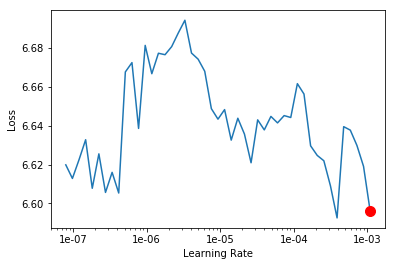

In [160]:
learn.lr_find(start_lr=1e-08)
learn.recorder.plot(suggestion=True, skip_end=35)

Min numerical gradient: 2.51E-03
Min loss divided by 10: 7.08E-04


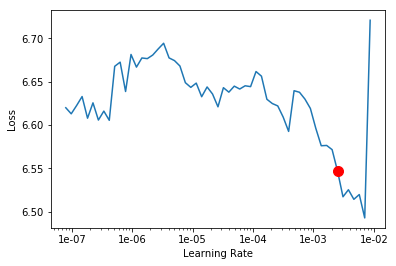

In [162]:
learn.recorder.plot(suggestion=True, skip_end=25)

In [163]:
learn.fit_one_cycle(10, slice(1e-03))

epoch,train_loss,valid_loss,time
0,6.568778,5.758547,00:04
1,6.391194,5.677843,00:04
2,6.106501,4.952978,00:03
3,5.885322,5.213315,00:04
4,5.701199,4.702845,00:03
5,5.579083,4.861491,00:04
6,5.403492,4.716962,00:04
7,5.240573,4.489025,00:04
8,5.097446,4.417565,00:04
9,4.964262,4.401059,00:04


In [164]:
learn.save(MODEL_PATH/'stage-6')

In [123]:
def softmax(preds):
    return (preds.exp()/(preds.exp().sum(-1, keepdim=True)))

def show_pred_next_to_ground_truth(idx, xb, yb, preds, thresh=None):    
    y_coords, y_cls = yb    
    
    target_coords, target_cls = get_nonzero(y_coords[idx], y_cls[idx])    

    # because get_nonzero divides by 224    
    pred_cls, pred_coords = preds
    pred_cls_mvals, pred_cls_midx = pred_cls[idx][:, 1:].max(dim=1)
    
    # Compute threshold
    threshold = [thresh] if thresh else [0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.15, 0.1, 0.099, 0.08, 0.05, 0.02]    
    for _, i in enumerate(threshold):
        #print(torch.argmax(pred_cls_mvals.cpu()))
        #idx_cls = (softmax(pred_cls_mvals) * 10) > i
        idx_cls = pred_cls_mvals.sigmoid() > i       
        if idx_cls.sum() == 0: continue
        else:
            print(f'Threshold at :{i}')
            break
    
    
    pred_final_cls = (pred_cls_midx + 1) * (idx_cls).long()        
    img = Image(denormalize(xb[idx].cpu(), *tensor(imagenet_stats)))
    
    # Ground Truth
    img_bbox =  ImageBBox.create(*img.size, target_coords.cpu(), 
                                 labels=target_cls, 
                                 classes=data.classes, scale=False)
    
    # Prediction    
    p_final_actn = actn_to_bb(pred_coords[idx].cuda(), anchors.cuda(), grid_sizes.cuda())
    p_final_bbox = p_final_actn.cuda().index_select(dim=0, 
                                                    index=idx_cls.nonzero().squeeze().cuda())
    
    
    p_final_cls = pred_final_cls.index_select(dim=0,
                                              index=idx_cls.nonzero().squeeze())
    p_final_cls = p_final_cls 
    p_final_labels = [data.classes[c] for c  in p_final_cls]
    
    pred_img_bbox = ImageBBox.create(*img.size, p_final_bbox.cpu(), 
                                     labels=p_final_cls, 
                                     classes=data.classes, scale=False)
    
    # display
    fix, axes = plt.subplots(1, 2, figsize=(10, 6))
    img.show(ax=axes[0], y=img_bbox, title='Ground Truth')
    img.show(ax=axes[1], y=pred_img_bbox, title='Prediction')

In [165]:
iter0 = iter(learn.data.valid_dl)
    

Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.3
Threshold at :0.2
Threshold at :0.3
Threshold at :0.3
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.3


/home/ec2-user/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.3
Threshold at :0.2
Threshold at :0.2
Threshold at :0.3
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.3
Threshold at :0.2
Threshold at :0.3
Threshold at :0.2
Threshold at :0.3
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.3
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2
Threshold at :0.2


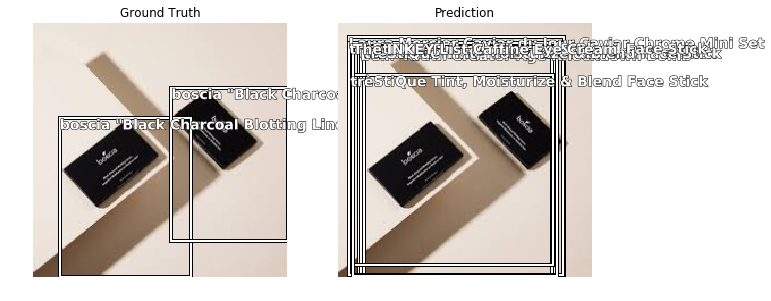

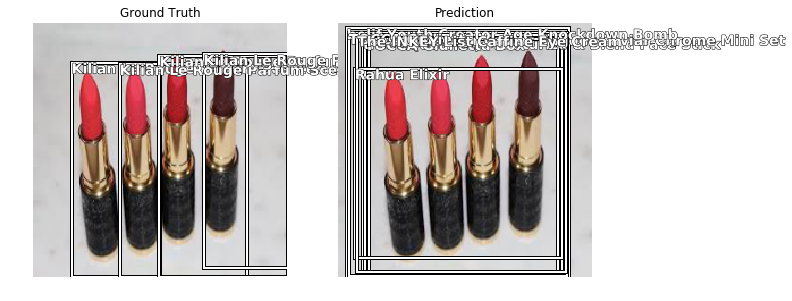

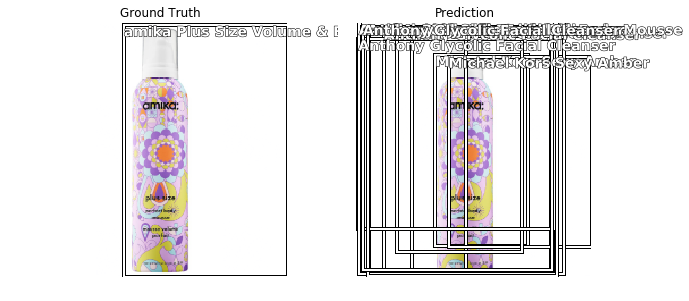

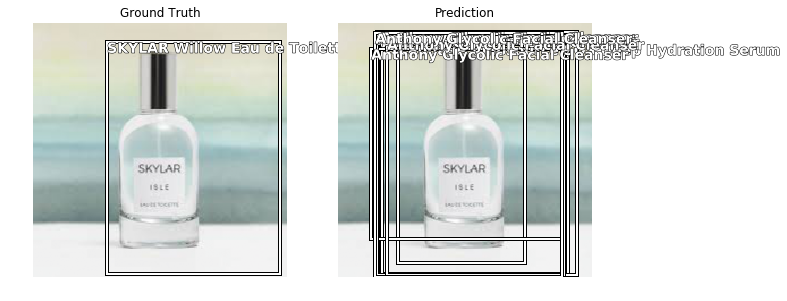

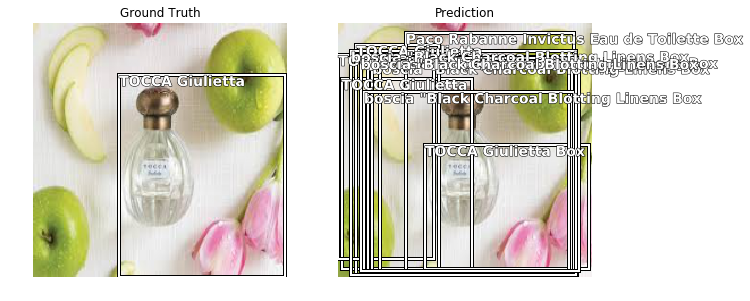

...

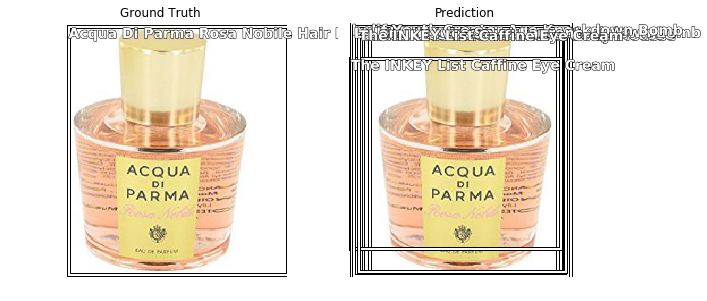

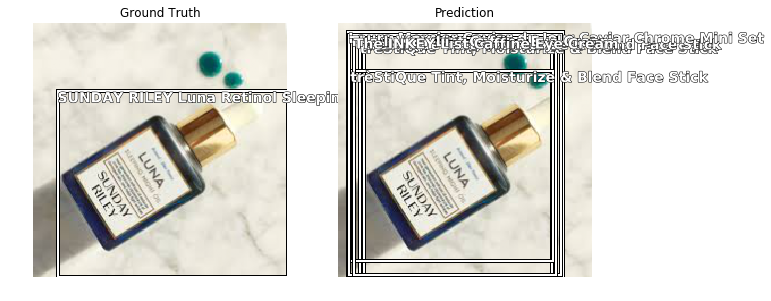

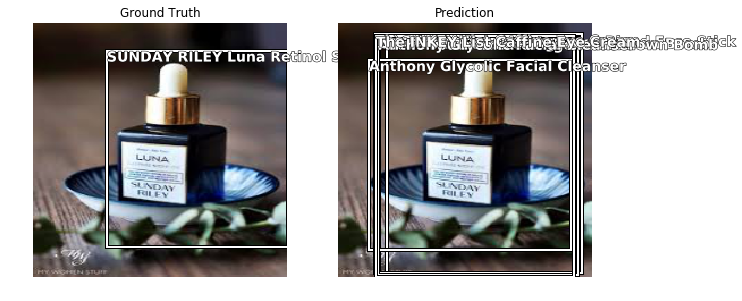

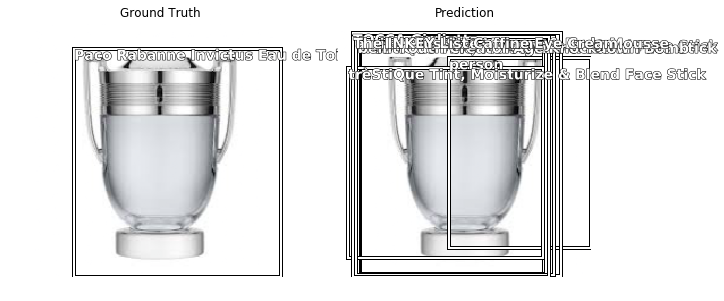

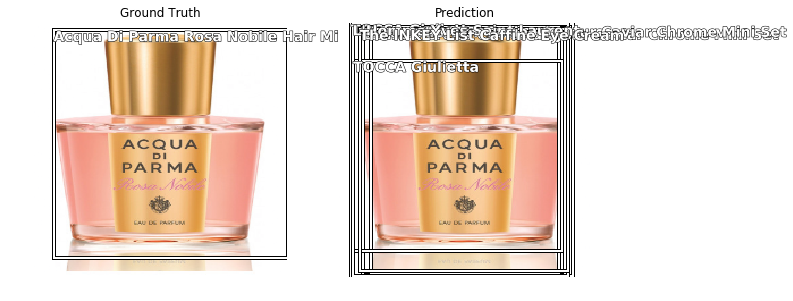

In [166]:
for batch in iter0:    
    _xb, _yb = batch
    p = learn.pred_batch(batch=batch)
    for i in range(len(_xb) - 1): show_pred_next_to_ground_truth(i, _xb, _yb, p)

In [137]:
b = next(iter0)

In [138]:
_xb, _yb = b


    


Threshold at :0.3
Threshold at :0.3
Threshold at :0.3
Threshold at :0.3
Threshold at :0.3
Threshold at :0.3
Threshold at :0.3
Threshold at :0.3
Threshold at :0.3
Threshold at :0.3
Threshold at :0.3
Threshold at :0.3
Threshold at :0.3
Threshold at :0.3
Threshold at :0.3
Threshold at :0.3


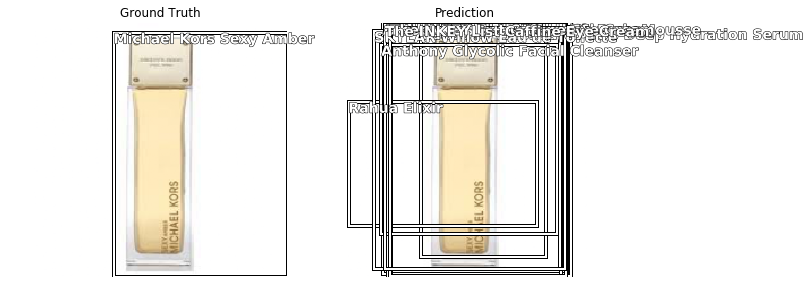

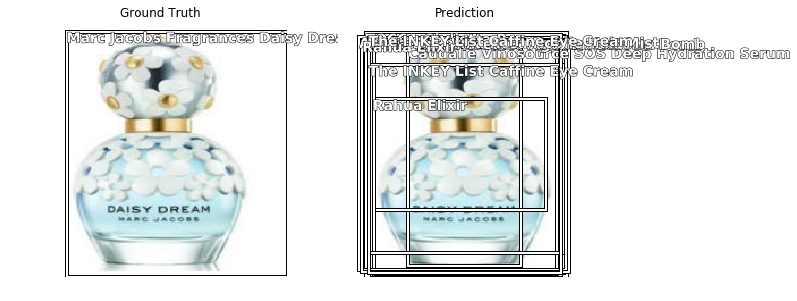

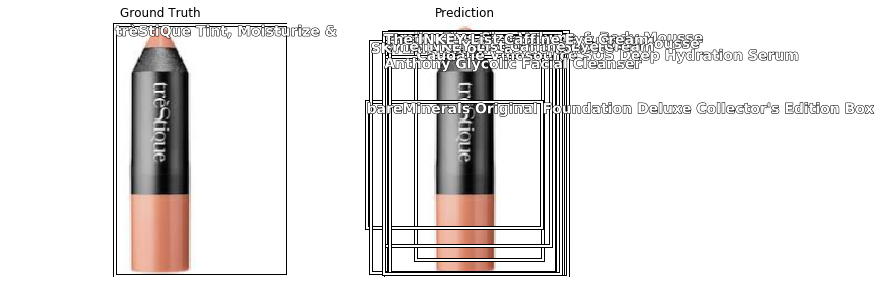

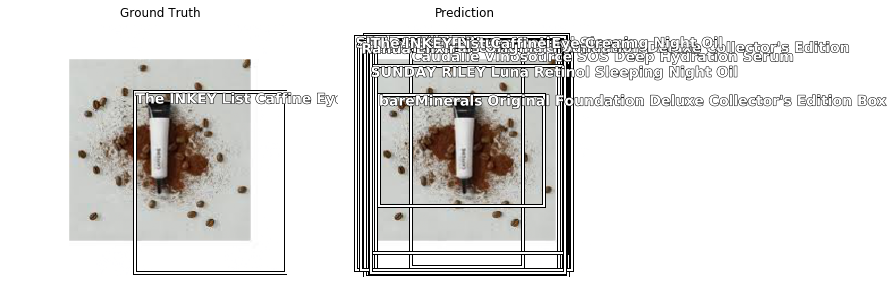

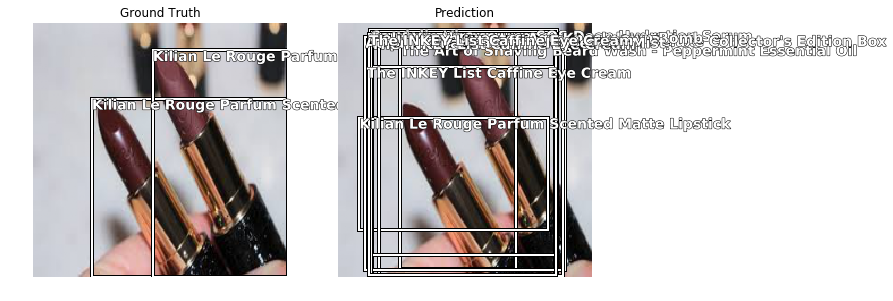

...

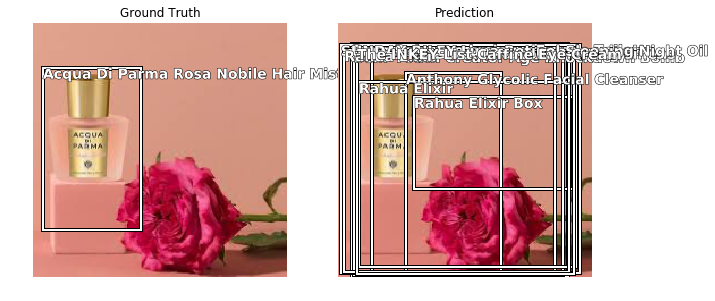

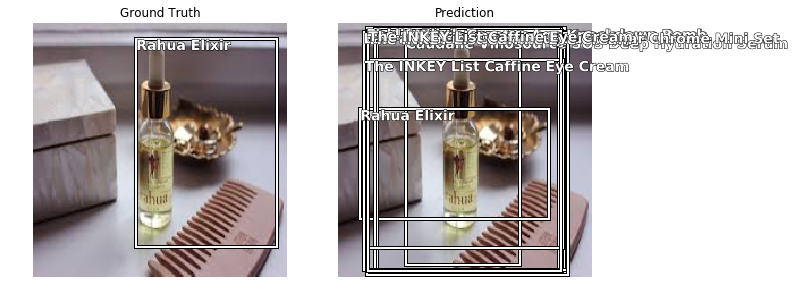

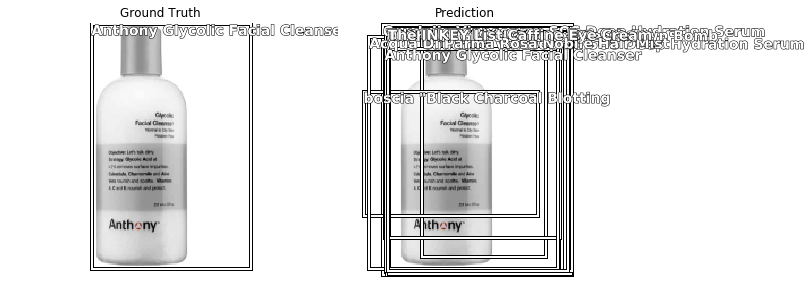

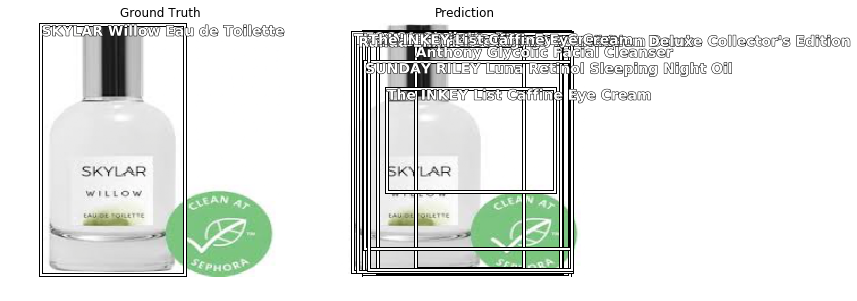

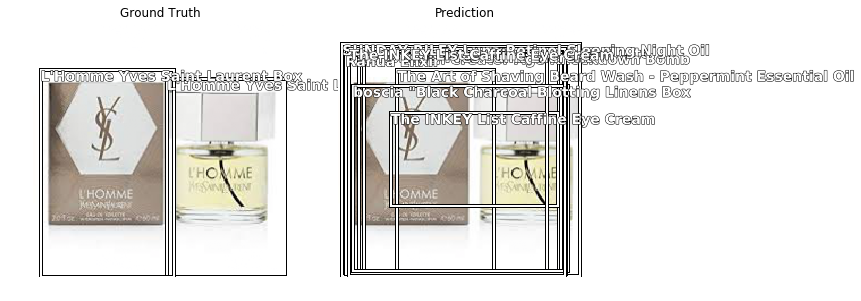

In [249]:
from fastai.vision import ImageBBox

In [167]:
def nms(boxes, scores, overlap=0.5, top_k=100):
    keep = scores.new(scores.size(0)).zero_().long()
    if boxes.numel() == 0: return keep
    x1 = boxes[:, 0]
    y1 = boxes[:, 1]
    x2 = boxes[:, 2]
    y2 = boxes[:, 3]
    area = torch.mul(x2 - x1, y2 - y1)
    v, idx = scores.sort(0)  # sort in ascending order
    idx = idx[-top_k:]  # indices of the top-k largest vals
    xx1 = boxes.new()
    yy1 = boxes.new()
    xx2 = boxes.new()
    yy2 = boxes.new()
    w = boxes.new()
    h = boxes.new()

    count = 0
    while idx.numel() > 0:
        i = idx[-1]  # index of current largest val
        keep[count] = i
        count += 1
        if idx.size(0) == 1: break
        idx = idx[:-1]  # remove kept element from view
        # load bboxes of next highest vals
        torch.index_select(x1, 0, idx, out=xx1)
        torch.index_select(y1, 0, idx, out=yy1)
        torch.index_select(x2, 0, idx, out=xx2)
        torch.index_select(y2, 0, idx, out=yy2)
        # store element-wise max with next highest score
        xx1 = torch.clamp(xx1, min=x1[i])
        yy1 = torch.clamp(yy1, min=y1[i])
        xx2 = torch.clamp(xx2, max=x2[i])
        yy2 = torch.clamp(yy2, max=y2[i])
        w.resize_as_(xx2)
        h.resize_as_(yy2)
        w = xx2 - xx1
        h = yy2 - yy1
        # check sizes of xx1 and xx2.. after each iteration
        w = torch.clamp(w, min=0.0)
        h = torch.clamp(h, min=0.0)
        inter = w*h
        # IoU = i / (area(a) + area(b) - i)
        rem_areas = torch.index_select(area, 0, idx)  # load remaining areas)
        union = (rem_areas - inter) + area[i]
        IoU = inter/union  # store result in iou
        # keep only elements with an IoU <= overlap
        idx = idx[IoU.le(overlap)]
    return keep, count



def process_nmf(idx, debug=True):
    '''
    Connects to the nmf algorith to filter out dupplicate bounding boxes
    ''' 
    # Minimun threshold for eliminating background noise
    min_thresh = 0.2   #0.25
    
    # Maximun threshold for eliminating duplicate boxes
    max_thresh = 0.32 
    
     # Extract predicted classes
    clas_pr, clas_ids = b_clas[idx].max(dim=1)

    
    # Mask Index of classes whose contents are over the noise level: 0 if the index contains no boxes, 1 if it does
    clas_pr = clas_pr.sigmoid()    
    
    # Calculate confidence score for Class Activations
    conf_scores = b_clas[idx].sigmoid().t().data      
    
    
    
    # Converts activation vectors to boxes. Shape: 189 x 4
    p_final_bbox = actn_to_bb(b_bb[idx].cpu(), anchors, grid_sizes=grid_sizes) 
    
    # lists for accumulating selected boxes and classes
    tot_bx, tot_cls = [], []
    
    scrd_cls_lst = data.classes.copy()
  
    # Loop across all classes
    for cl in range(0, len(conf_scores)):
        
        # Filter out Backgrounds and empty box arrays        
        c_mask = conf_scores[cl] > min_thresh         
        if c_mask.sum() == 0 or cl == 0: continue
        
        
        # scores for the selected class 
        scores = conf_scores[cl][c_mask] # Tensor 
           
        # These are active boxes. Ready to be processed by nmf
        boxes = p_final_bbox.cpu().index_select(dim=0,index=c_mask.nonzero().squeeze())
        
        # Run NMF
        ids, count = nms(boxes.data, scores, overlap=0.5, top_k=3)
        ids = ids[:count]
        
    
        
        # Filter all boxes & classes over the threshold and accumulate them in lists
        for i, (sc, bx) in enumerate(zip(scores, boxes.data[ids] )): 
                 
            tot_bx.append(bx)
            tot_cls.append(cl)
            # Create a scored label
            f = f'{i}: '           
            l = f'{data.classes[cl]} '
            s = '{0:.2f}'.format(sc) 
            sl = f+l+s
            # print('scored label: {} '.format(sl))
            scrd_cls_lst[cl] = sl

                
    if not tot_cls:
        print('Inferred Class list is empty. Image may be too faint.')
        return None, None, None  
    
    return torch.cat(tot_bx).view(-1, 4), torch.tensor((np.array(tot_cls))), scrd_cls_lst


# Filter Single Image
def show_filtered_img_by_ndx(idx):
    
    
    # Prepare ground-truth image for display
#     img = vision.Image(denormalize(xb[idx],*tensor(imagenet_stats)))        
    img = vision.Image(denormalize(xb[idx], *tensor(imagenet_stats)))
    img_box = ImageBBox.create(224,224,yb_cords[idx].cpu(),labels=yb_classes[idx],classes=data.classes,scale=False)
    
    # Unpad Y (ground-truth boxes and classes )
    t_bbox,t_clas = get_nonzero(yb_cords[idx], yb_classes[idx])
     
    # Process NMF 
    tot_bx, tot_cls, scrd_cls_lst = process_nmf(idx)  # Filter dupplicate boxes
    if tot_bx is None: return            
    
    # Compose the image, bouding boxes, ans classes for display
    p_img_box = ImageBBox.create(224,224,tot_bx.cpu(),tot_cls.cpu(),classes=scrd_cls_lst,scale=False)
  
    # Display resulting image, selected bounding boxes, and class labels
    fig,axes = plt.subplots(1,2,figsize=(10,6))
    img.show(ax=axes[0],y=img_box,title='Ground Truth')
    img.show(ax=axes[1],y=p_img_box,title='Prediction')
   

In [169]:
iter_ = iter(learn.data.valid_dl)

/home/ec2-user/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


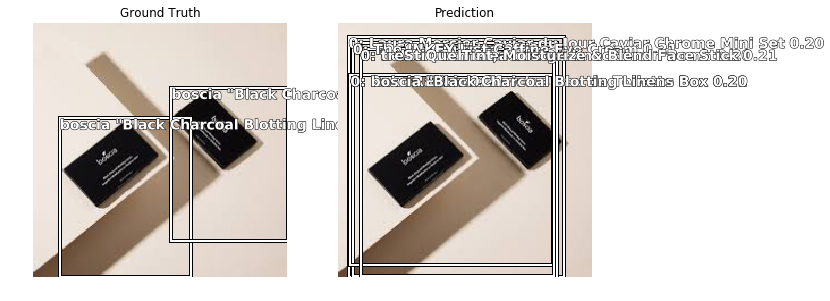

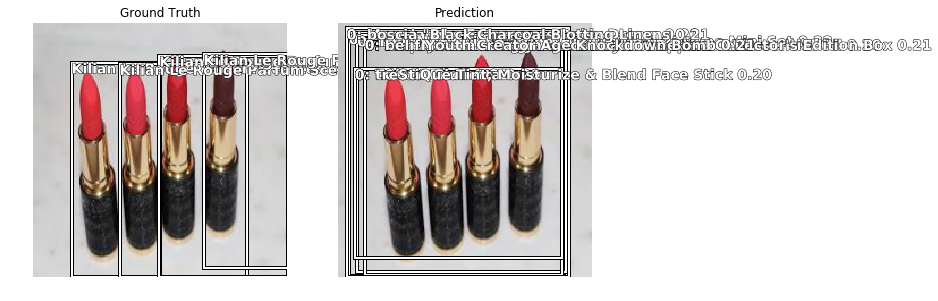

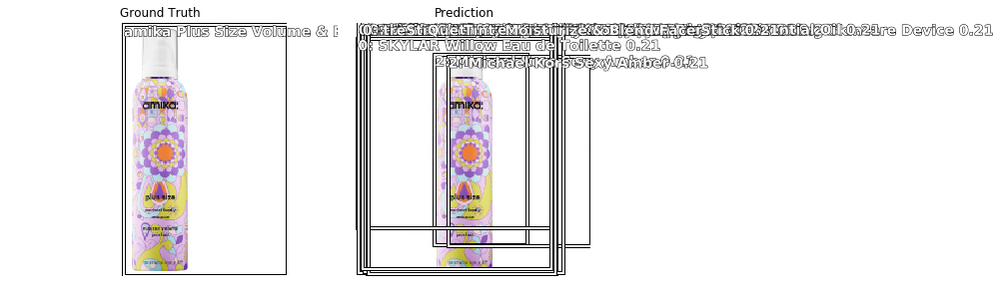

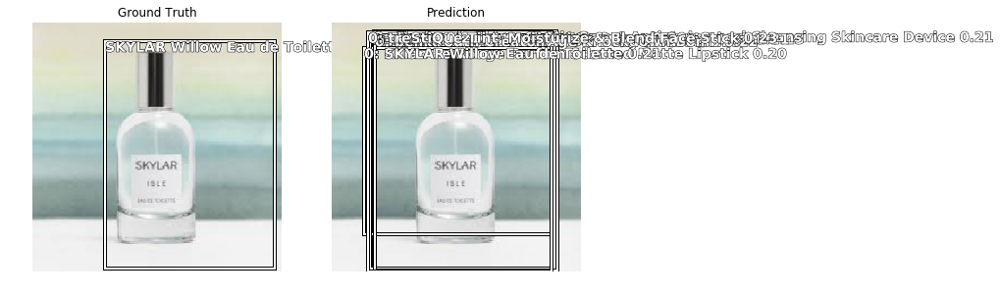

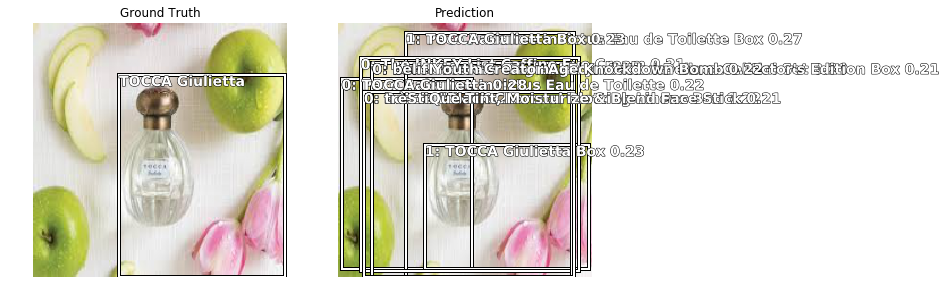

...

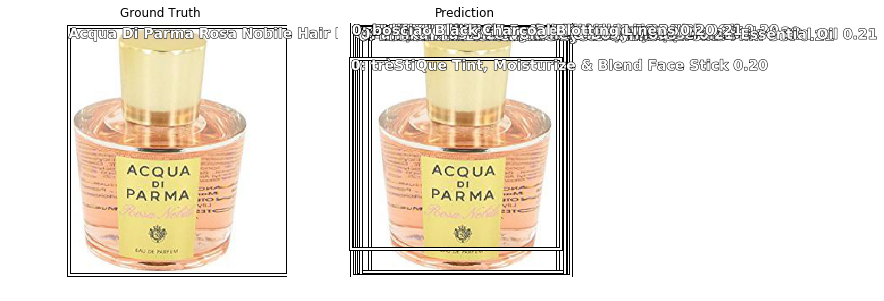

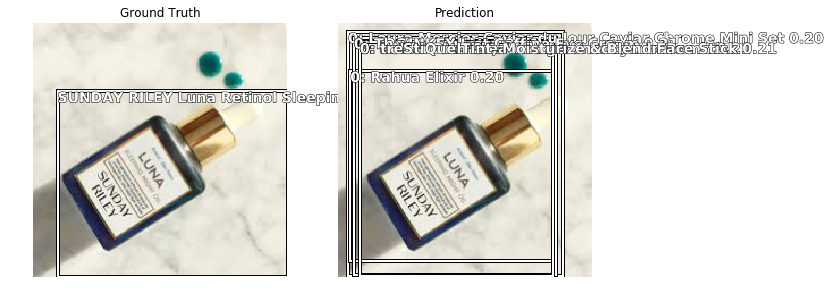

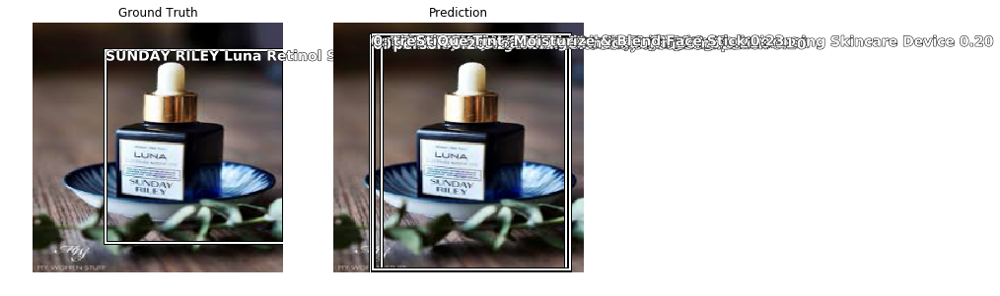

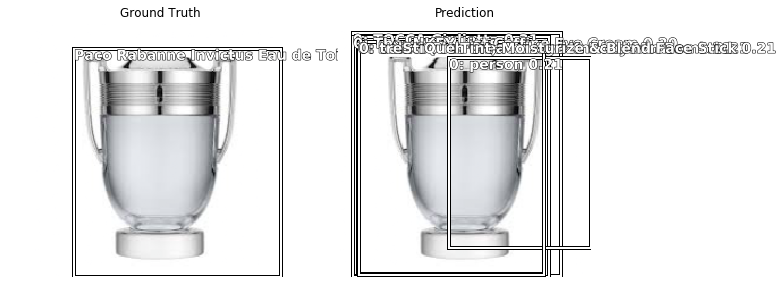

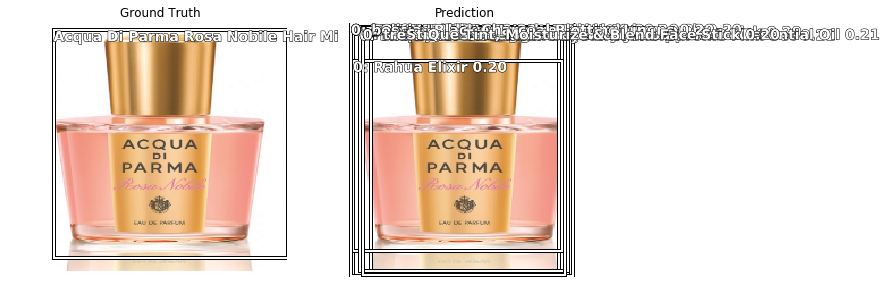

In [170]:
for bh in iter_:
    xb, yb = bh
    preds = learn.pred_batch(batch=bh)
    b_clas, b_bb = preds
    yb_cords, yb_classes = yb[0], yb[1]
    for i in range(0, len(xb) - 1): show_filtered_img_by_ndx(i)

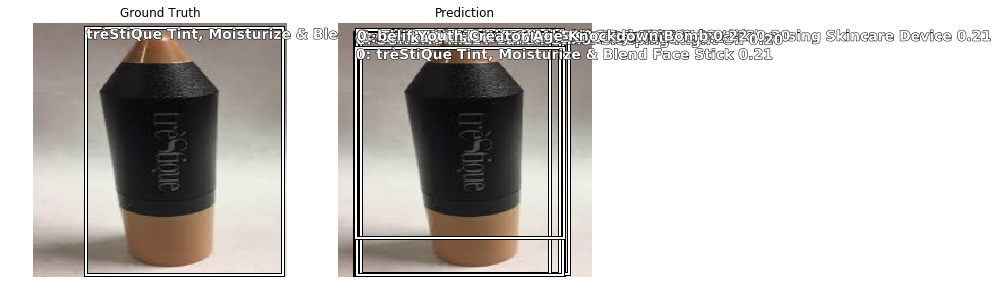

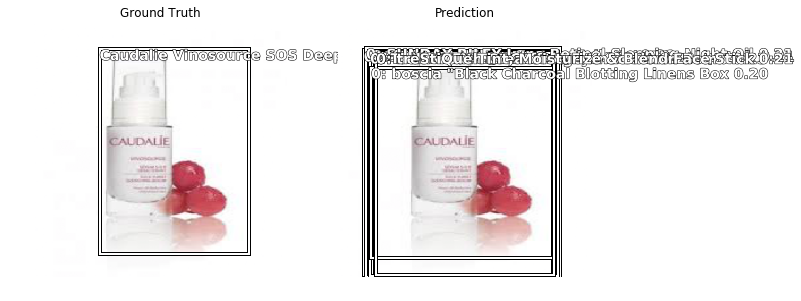

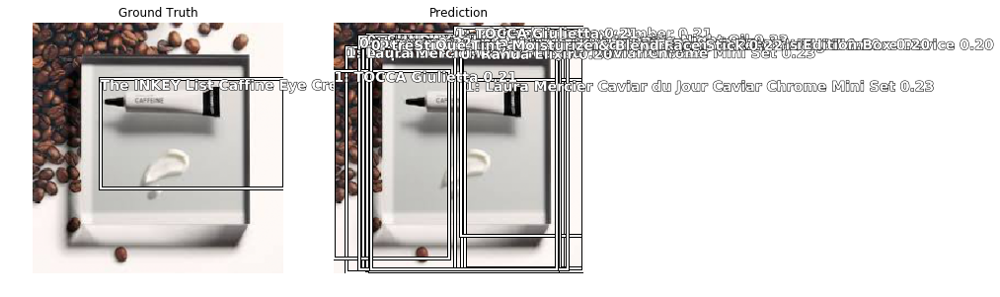

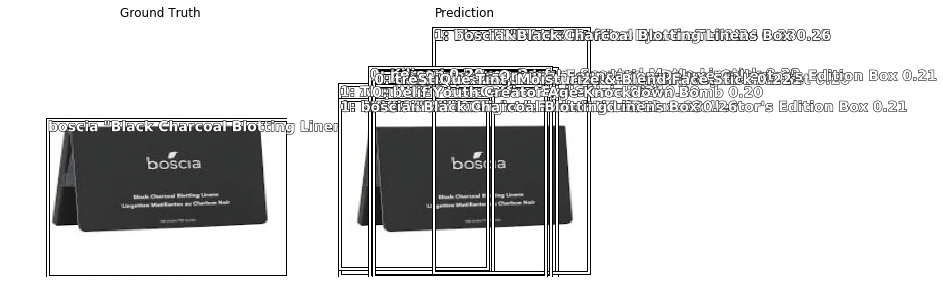

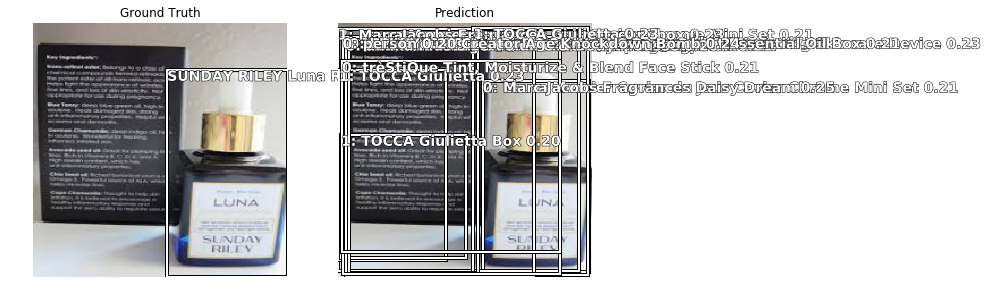

...

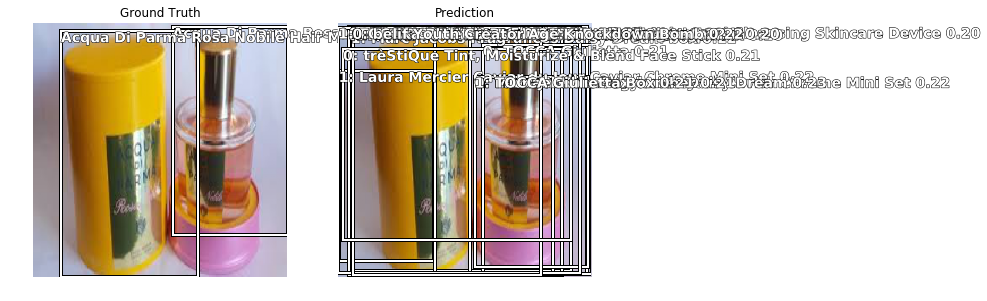

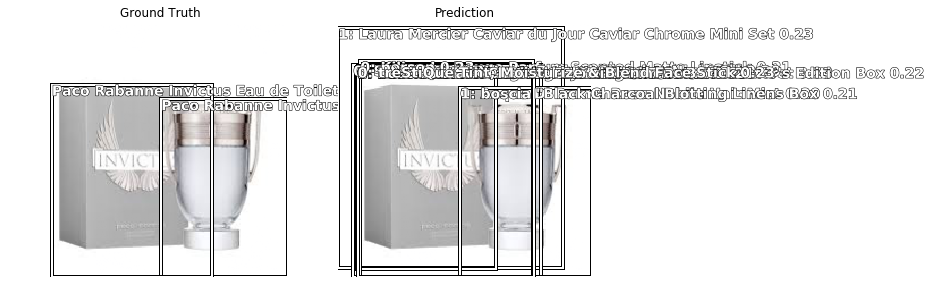

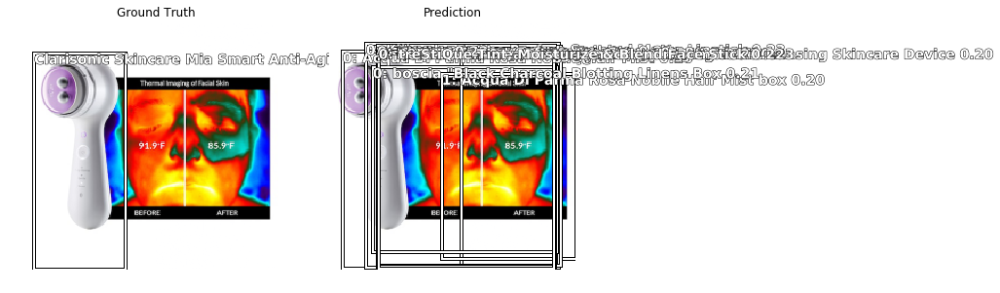

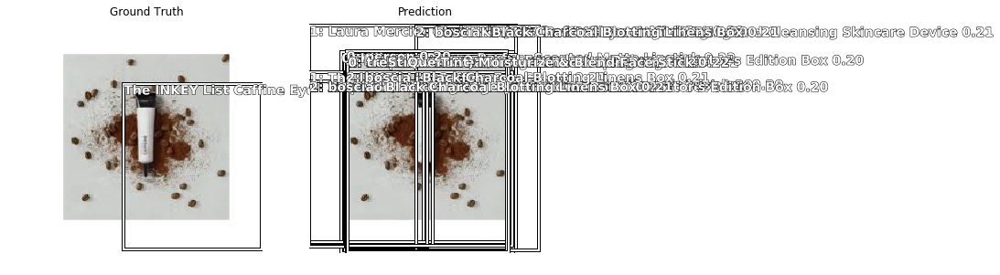

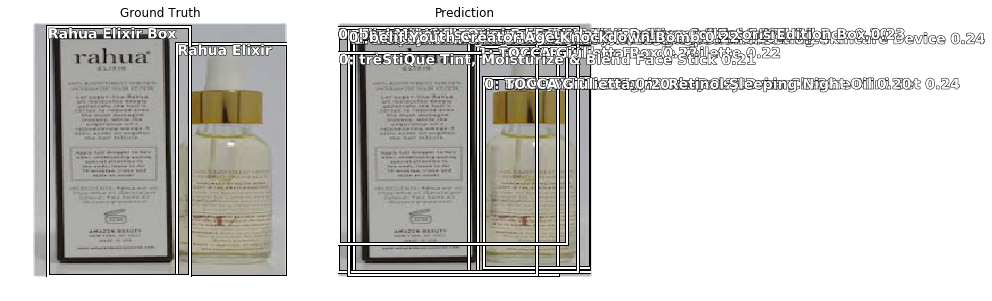